In [2]:
import os
import glob
import re
import shutil
import matplotlib.pyplot as plt
import pydicom
import numpy as np
import pandas as pd
from PIL import Image
import tempfile
import zipfile

In [3]:
a=np.array([1,2,3,4,5,6,7])
a[..., np.newaxis].shape

(7, 1)

In [ ]:
#from pydicom.data import get_testdata_files
#filename = get_testdata_files("CT_small.dcm")[0]
ds = pydicom.dcmread(filename)
plt.imshow(ds.pixel_array, cmap=plt.cm.bone) 

In [ ]:
filename = "/mnt/idms/PROJECTS/Lung/Kaggle-data/cancer_cases/home/peter/lung/data/stage1/stage1/229b8b785f880f61d8dad636c3dc2687/f1a23adea3019e89e938f9de24887ae6.dcm"
ds = pydicom.dcmread(filename)
print((ds.pixel_array).shape)

plt.imshow(ds.pixel_array, cmap=plt.cm.bone)

data_img = Image.fromarray(ds.pixel_array)
data_img_rotated = data_img.rotate(angle=45,resample=Image.BICUBIC,fillcolor=data_img.getpixel((0,0)))
print(type(data_img_rotated))
plt.imshow(data_img_rotated)

In [ ]:
from PIL import Image
data_img = Image.fromarray(ds.pixel_array)
data_img_rotated = data_img.rotate(angle=45,resample=Image.BICUBIC,fillcolor=data_img.getpixel((0,0)))

In [21]:
os.makedirs(os.path.join("./DSB2017/prep_result/","46372/SE3217637").rsplit('/',1)[0], exist_ok=True)

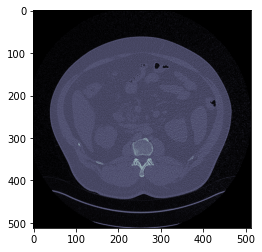

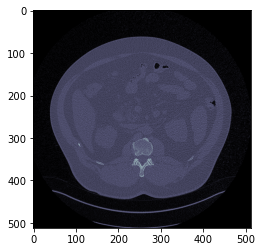

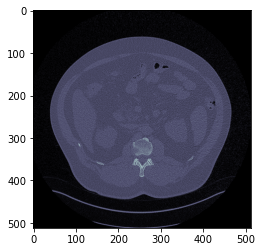

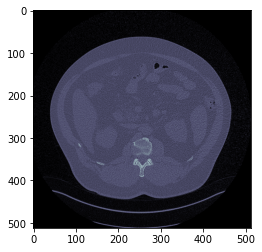

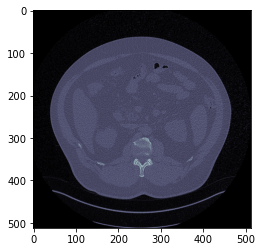

...

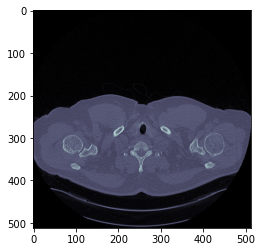

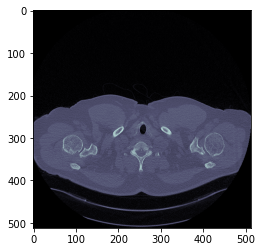

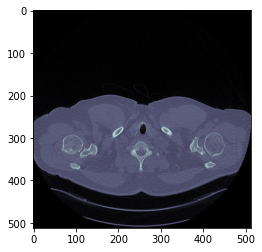

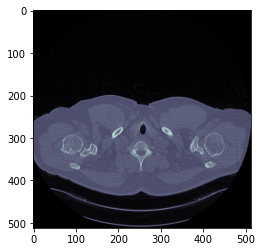

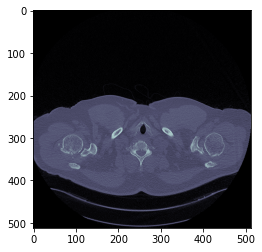

In [16]:
slices = [pydicom.read_file(s) for s in glob.glob("/mnt/idms/PROJECTS/Lung/Ulyssys-Lung-Data/56473/SE000006/*.dcm")]
slices.sort(key = lambda x: float(x.ImagePositionPatient[2]))
for ds in slices:
    plt.figure()
    plt.imshow(ds.pixel_array, cmap=plt.cm.bone)
    plt.show()

In [24]:
slices = [pydicom.read_file(s) for s in glob.glob("./LymphoglandulaeMetastasis/54841/SE000006/*.dcm")]
slices.sort(key = lambda x: float(x.ImagePositionPatient[2]))


KeyboardInterrupt: 

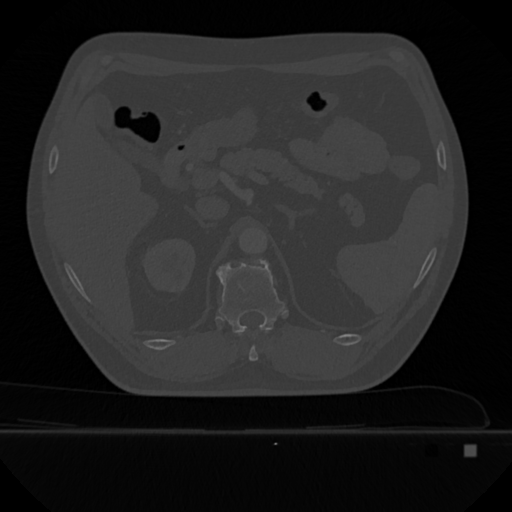

(512, 512)


In [42]:
arr=slices[0].pixel_array
arr_norm = (arr/4095.0)*256
Image.fromarray(arr_norm).show()
print(slices[0].pixel_array.shape)

In [13]:
np.save("./DSB2017/prep_result/53966/SE000007_clean",np.zeros(4))

FileNotFoundError: [Errno 2] No such file or directory: './DSB2017/prep_result/53966/SE000007_clean.npy'

In [ ]:
filename_lymp = "/mnt/idms/PROJECTS/Lung/LymphoglandulaeMetastasis/SE000006/50848-0584.dcm"
filename_lung="/mnt/idms/PROJECTS/Lung/LungMetastasis/SE000004/54680-0545.dcm"
lidc="/mnt/idms/PROJECTS/Lung/1-128.dcm"

ds = pydicom.dcmread(lidc)
#print((ds.pixel_array).shape)

plt.imshow(ds.pixel_array, cmap=plt.cm.bone)

#data_img = Image.fromarray(ds.pixel_array)
#data_img_rotated = data_img.rotate(angle=45,resample=Image.BICUBIC,fillcolor=data_img.getpixel((0,0)))
#print(type(data_img_rotated))
#plt.imshow(data_img)

In [ ]:
no_num=len(glob.glob('./NoMetastasis/*.txt'))
lung_num=len(glob.glob('./LungMetastasis/*.txt'))
lymp_num=len(glob.glob('./LymphoglandulaeMetastasis/*.txt'))
ct_num=no_num+lung_num+lymp_num

In [ ]:
lung_labels=np.asarray([0]*no_num+[1]*lung_num+[0]*lymp_num).astype(np.float32)
lymp_labels=np.asarray([0]*no_num+[0]*lung_num+[1]*lymp_num).astype(np.float32)

In [ ]:
glob.glob('./NoMetastasis/*.txt')

In [ ]:


dir_name = './NoMetastasis/'
extension = ".zip"

In [ ]:
os.chdir(dir_name) # change directory from working dir to dir with files

for item in os.listdir(dir_name): # loop through items in dir
    if item.endswith(extension): # check for ".zip" extension
        file_name = os.path.abspath(item) # get full path of files
        zip_ref = zipfile.ZipFile(file_name) # create zipfile object
        zip_ref.extractall(dir_name) # extract file to dir
        zip_ref.close() # close file
        os.remove(file_name) # delete zipped file

In [ ]:
def unzip_nometa(path):
    with zipfile.ZipFile(path, 'r') as zip_ref:
        zip_ref.extractall(f"{path[:-4]}/")

In [ ]:
import multiprocessing as mp

In [ ]:
pool = mp.Pool(80)
pool.map(unzip_nometa, list(glob.glob('./NoMetastasis/*.zip')))

In [ ]:
for filename in glob.glob('./Tudo-Ulyssys/*.zip'):
    print(filename)
    with tempfile.TemporaryDirectory() as tmpdirname:
        with zipfile.ZipFile(filename, 'r') as zip_ref:
            zip_ref.extractall(f"{tmpdirname}/asd")
        print(len([name for name in os.listdir(tmpdirname) if os.path.isfile(name)]))

In [ ]:
s="./Tudo-Ulyssys/55308.zip"

In [ ]:
s[:-3]

In [ ]:
with zipfile.ZipFile(s, 'r') as zip_ref:
    zip_ref.extractall(f"./hello")

In [1]:
import multiprocessing

multiprocessing.cpu_count()

80

In [2]:
4+3

7

In [5]:
a=np.array([0,0,0,0,1,0,1,0,1,1,0,1,0,1])

In [6]:
(a==0).sum()

8

In [7]:
(a==1).sum()

6

In [23]:
path="/mnt/idms/PROJECTS/Lung/Tudo-Ulyssys-Unzipped/53101/SE000012.npz"
a=np.load(path)

In [24]:
type(a)

numpy.lib.npyio.NpzFile

In [21]:
a=a['SE000012']

In [16]:
np.moveaxis(a, 2, 0).shape

(600, 512, 512)